# Analise dos Textos para Roma 2023

In [1]:
import os
import PyPDF2
import psycopg2 # sql databse
import pandas as pd #dataframes
import nltk # nlp 
from nltk.corpus import stopwords
#from wordcloud import WordCloud
import matplotlib.pyplot as plt # visualization
from platform import python_version
import sys,os
#from sklearn.feature_extraction.text import TfidfVectorizer
import numpy as np
import matplotlib.pyplot as plt
#from sklearn.cluster import KMeans
#from sklearn.datasets import make_blobs
import pyttsx3
import pyttsx3
import subprocess
import re
import time
import nltk
from nltk.tokenize import word_tokenize
from nltk.corpus import stopwords
from wordcloud import WordCloud
import matplotlib.pyplot as plt

## Gera os TXTs usando os PDFs

In [2]:

# function to read a pdf file and generate a text file of the same name
def pdf_to_text(pdf_file):
    import PyPDF2
    pdf_file_object = open(pdf_file, 'rb')
    pdf_reader = PyPDF2.PdfReader(pdf_file_object)
    num_pages = len(pdf_reader.pages)
    count = 0
    text = ""
    while count < num_pages:
        page_object = pdf_reader.pages[count]
        count += 1
        text += page_object.extract_text()
    if text != "":
        text = text
    else:
        text = textract.process(pdf_file, method='tesseract', language='eng')
    text_file = pdf_file[:-4] + '.txt'
    text_file_object = open(text_file, 'wb')
    text_file_object.write(text.encode('utf-8'))
    text_file_object.close()
    return text_file

In [3]:
# write a function to read ll files in a dir and generate a list of text files
def pdf_to_text_all(pdf_dir):
    import os
    pdf_files = os.listdir(pdf_dir)
    text_files = []
    for pdf_file in pdf_files:
        print(pdf_file)
        text_file = pdf_to_text(pdf_dir + pdf_file)
        text_files.append(text_file)
    return text_files

In [35]:
pdf_to_text_all("teses/")

arq56.pdf
arq83.pdf
arq40.pdf
arq54.pdf
arq55.pdf
arq86.pdf
arq45.pdf
arq51.pdf
arq78.pdf
arq50.pdf
arq44.pdf
arq87.pdf
arq85.pdf
arq52.pdf
arq46.pdf
arq47.pdf
arq53.pdf
arq84.pdf
arq90.pdf
arq08.pdf
arq34.pdf
arq35.pdf
arq09.pdf
arq23.pdf
arq37.pdf
arq36.pdf
arq22.pdf
arq26.pdf
arq32.pdf
arq27.pdf
arq31.pdf
arq25.pdf
arq19.pdf
arq18.pdf
arq30.pdf
arq29.pdf
arq15.pdf
arq01.pdf
arq14.pdf
arq28.pdf
arq02.pdf
arq17.pdf
arq03.pdf
arq07.pdf
arq13.pdf
arq12.pdf
arq06.pdf
arq10.pdf
arq04.pdf
arq38.pdf
arq39.pdf
arq05.pdf
arq11.pdf
arq89.pdf
arq63.pdf


In [9]:
nltk.download('averaged_perceptron_tagger')
nltk.download('stopwords')
nltk.download('punkt')
snowball=nltk.SnowballStemmer("english")


[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     /Users/neylemke/nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package stopwords to
[nltk_data]     /Users/neylemke/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to /Users/neylemke/nltk_data...
[nltk_data]   Package punkt is already up-to-date!


In [20]:
snowball=nltk.SnowballStemmer("portuguese")


In [23]:
# select stopwords in portuguese
stopwords = nltk.corpus.stopwords.words('portuguese')



In [24]:
stopwords

['a',
 'à',
 'ao',
 'aos',
 'aquela',
 'aquelas',
 'aquele',
 'aqueles',
 'aquilo',
 'as',
 'às',
 'até',
 'com',
 'como',
 'da',
 'das',
 'de',
 'dela',
 'delas',
 'dele',
 'deles',
 'depois',
 'do',
 'dos',
 'e',
 'é',
 'ela',
 'elas',
 'ele',
 'eles',
 'em',
 'entre',
 'era',
 'eram',
 'éramos',
 'essa',
 'essas',
 'esse',
 'esses',
 'esta',
 'está',
 'estamos',
 'estão',
 'estar',
 'estas',
 'estava',
 'estavam',
 'estávamos',
 'este',
 'esteja',
 'estejam',
 'estejamos',
 'estes',
 'esteve',
 'estive',
 'estivemos',
 'estiver',
 'estivera',
 'estiveram',
 'estivéramos',
 'estiverem',
 'estivermos',
 'estivesse',
 'estivessem',
 'estivéssemos',
 'estou',
 'eu',
 'foi',
 'fomos',
 'for',
 'fora',
 'foram',
 'fôramos',
 'forem',
 'formos',
 'fosse',
 'fossem',
 'fôssemos',
 'fui',
 'há',
 'haja',
 'hajam',
 'hajamos',
 'hão',
 'havemos',
 'haver',
 'hei',
 'houve',
 'houvemos',
 'houver',
 'houvera',
 'houverá',
 'houveram',
 'houvéramos',
 'houverão',
 'houverei',
 'houverem',
 'hou

In [4]:
 pdf_to_text("teses/arq22.pdf")

'teses/arq22.txt'

In [13]:
# function to scan a pdf file using ocr and generate a text file of the same name
def pdf_to_text_ocr(pdf_file):
    import textract
    text = textract.process(pdf_file, method='tesseract', language='por')
    text_file = pdf_file[:-4] + '.txt'
    text_file_object = open(text_file, 'wb')
    text_file_object.write(text)
    text_file_object.close()
    return text_file



In [ ]:
!more teses/arq22.txt

In [37]:
 pdf_to_text_ocr("teses/arq67.pdf")

In [ ]:


# Download stopwords for Portuguese
nltk.download('stopwords')
stopwords_pt = set(stopwords.words('portuguese'))

# Initialize an empty dictionary for word counts
word_counts = {}

# Define the chunk size for reading the file
chunk_size = 10000

# Open the file
with open('large_file.txt', 'r', encoding='utf-8') as file:
    # Read the file in chunks
    while True:
        # Read a chunk of text
        chunk = file.read(chunk_size)
        if not chunk:
            break  # Exit the loop if no more data is available
        
        # Tokenize the chunk into individual words
        tokens = word_tokenize(chunk, language='portuguese')

        # Remove stopwords and punctuation
        words = [word.lower() for word in tokens if word.isalpha() and word.lower() not in stopwords_pt]

        # Update word counts
        for word in words:
            word_counts[word] = word_counts.get(word, 0) + 1

# Generate word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_counts)

# Display the word cloud using matplotlib
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()


In [35]:
#define a function to read a text file and generate a list of wordcloud images
def wordcloud_all(text_files):
    import nltk
    from nltk.tokenize import word_tokenize
    from nltk.corpus import stopwords
    from wordcloud import WordCloud
    import matplotlib.pyplot as plt
    # Download stopwords for Portuguese
    nltk.download('stopwords')
    stopwords_pt = set(stopwords.words('portuguese'))
    for text_file in text_files:
        # Initialize an empty dictionary for word counts
        word_counts = {}
        # Define the chunk size for reading the file
        chunk_size = 10000
        # Open the file
        with open(text_file, 'r', encoding='utf-8') as file:
            # Read the file in chunks
            while True:
                # Read a chunk of text
                chunk = file.read(chunk_size)
                if not chunk:
                    break  # Exit the loop if no more data is available
                # Tokenize the chunk into individual words
                tokens = word_tokenize(chunk, language='portuguese')
                # Remove stopwords and punctuation
                words = [word.lower() for word in tokens if word.isalpha() and word.lower() not in stopwords_pt]
                # Update word counts
                for word in words:
                    word_counts[word] = word_counts.get(word, 0) + 1
        # Generate word cloud
        wordcloud = WordCloud(width=800, height=400, background_color='white').generate_from_frequencies(word_counts)
        # Display the word cloud using matplotlib
        plt.figure(figsize=(10, 5))
        plt.imshow(wordcloud, interpolation='bilinear')
        plt.axis('off')
        # Save the image in the img folder
        plt.savefig('wordclouds/' + text_file[6:-4] + '.png')
        plt.show()
    return

In [31]:
# list all files in a directory ending in .txt

import os
text_files = os.listdir("teses/") 
text_files = ["teses/"+file for file in text_files if file.endswith('.txt')]
 


[nltk_data] Downloading package stopwords to /home/lemke/nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


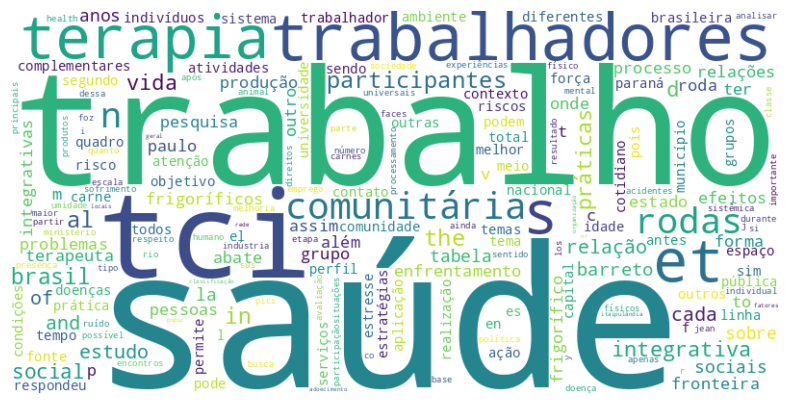

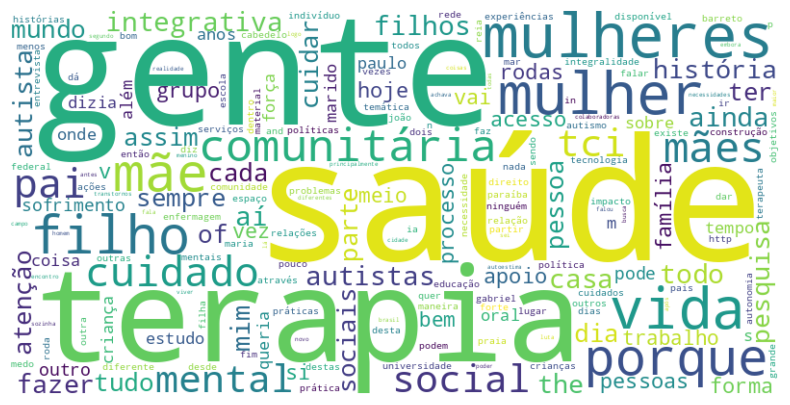

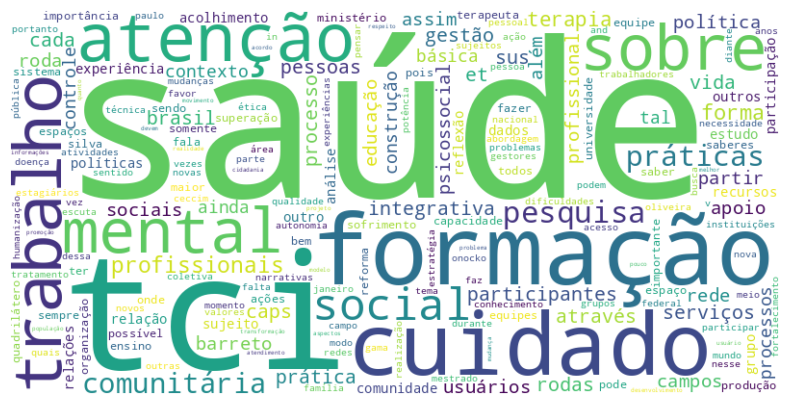

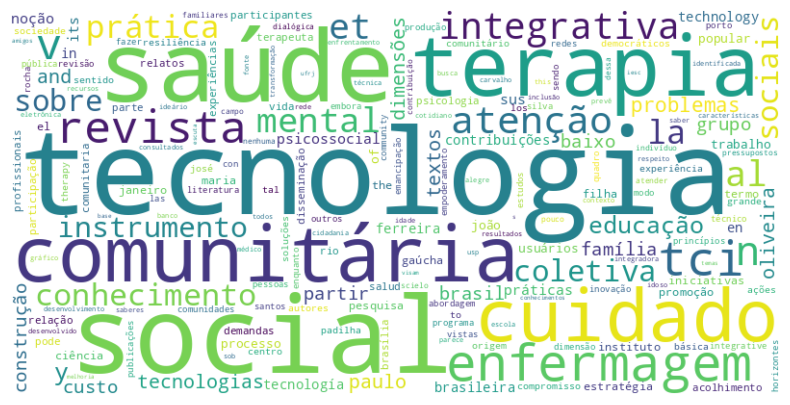

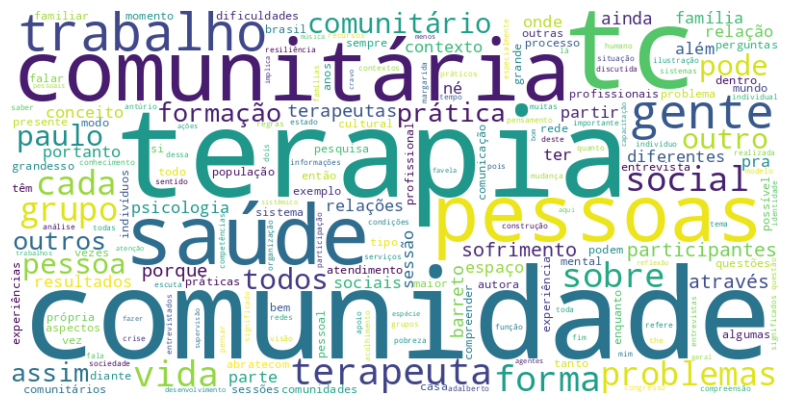

...

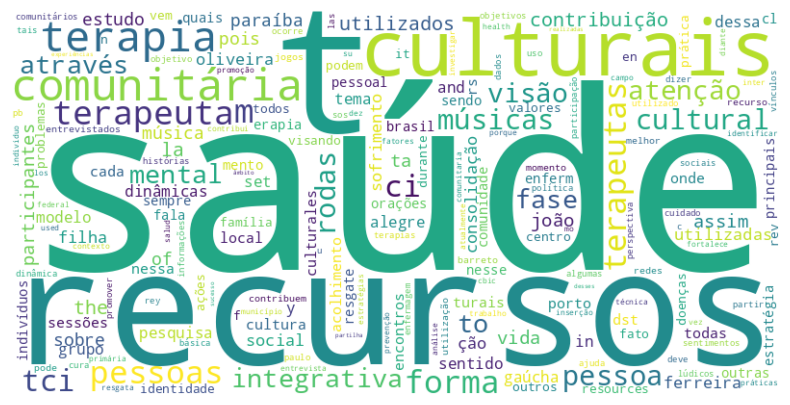

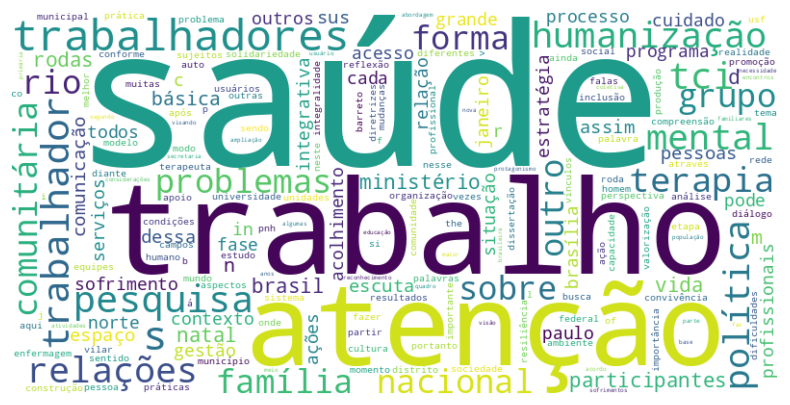

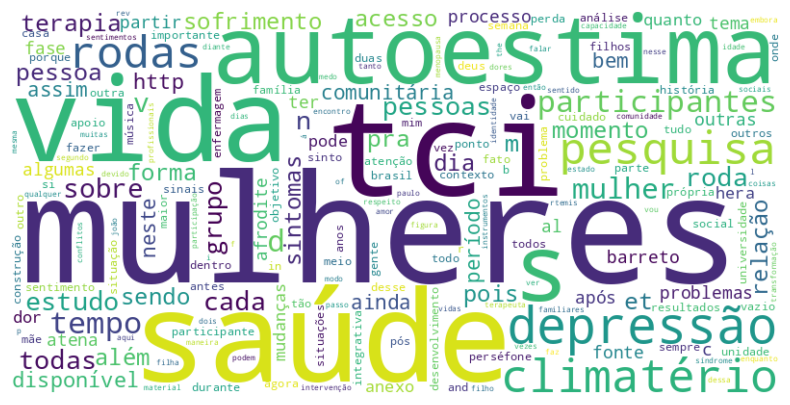

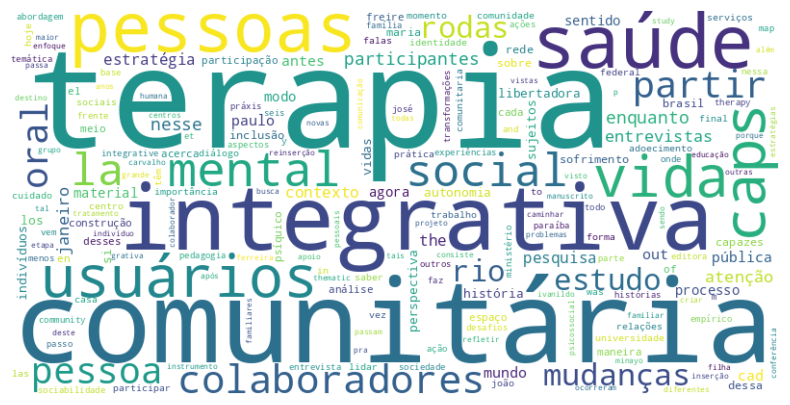

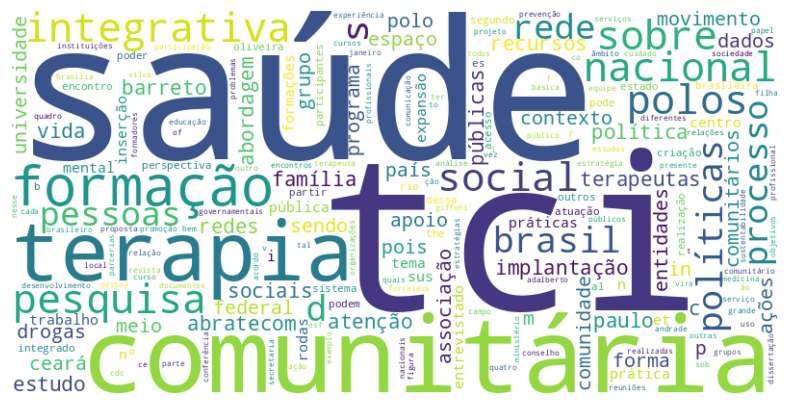

In [36]:
# generate wordclouds for all text files in a directory
wordcloud_all(text_files)